# **ES 114 Probability Lab Assignment - 5**

Name- Shardul Junagade

Roll no- 23110297

# **Histogram Equalization and Histogram Matching in Image Processing**

In this project, I implemented **Histogram Equalization** and **Histogram Matching** to manipulate and analyze the pixel intensity distributions of images.

### Understanding Histograms in Images
A histogram is a graphical representation that depicts the distribution of pixel intensities in an image. It provides a count of how many pixels have each intensity value across the possible range (e.g., 0–255 for 8-bit grayscale images). 

While histograms are effective for summarizing intensity information, they lose spatial information about how these intensities are distributed in the image. This means two visually distinct images can share an identical histogram.


## Importing Libraries

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
# from google.colab.patches import cv2_imshow

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import os

# Create directory if it does not exist
if not os.path.exists("Saved Results"):
    os.makedirs("Saved Results")

## Helper Functions

In [3]:
# Function defined to plot the image histogram
def plot_histogram(histogram):
  plt.bar(np.arange(len(histogram)),histogram)
  plt.ylabel("Number of Pixels")
  plt.xlabel("Pixel Intensity")
  
  
# Function defined to calculate the image histogram of any given iamge
def calculate_histogram(img,L=256):
  histogram=np.zeros(L, dtype=int)                # Initialize histogram array
  for x in range(img.shape[0]):
    for y in range(img.shape[1]):
      pixel_value= img[x][y].astype('int8')       # Find the intensity value of pixel
      histogram[pixel_value]+=1                   # Increment the histogram value at the corresponding intensity level
  return histogram

## Reading Images

In [4]:
# Read the images from the Dataset folder provided
img1=cv2.imread("./Dataset/histogram_matching/grey_1.png",0)  # Panda
img2=cv2.imread("./Dataset/histogram_matching/grey_2.png",0)  # Woman
img3=cv2.imread("./Dataset/histogram_matching/grey_3.png",0)  # IIT GN
img4=cv2.imread("./Dataset/histogram_matching/grey_4.png",0)  # Elon Musk

# **Histogram Equalization**

Histogram Equalization is a technique used to enhance the contrast of an image. It achieves this by redistributing pixel intensities to span the entire range of possible values uniformly. This is done by computing the **Cumulative Distribution Function (CDF)** of the histogram and using it to remap pixel intensities.

#### Steps for Histogram Equalization:
1. **Compute the histogram** of the input image.
2. **Calculate the CDF** of the histogram:
   $$
   CDF(v) = \sum_{i=0}^{v} \frac{h(i)}{N}
   $$
   where:
   - $ h(i) $ is the histogram value at intensity $ i $,
   - $ N $ is the total number of pixels in the image.
3. Use the CDF to **remap each pixel intensity** to a new value:
   $$
   I_{new}(x, y) = \text{round}\left((CDF(I(x, y)) - CDF_{min}) \times (L - 1)\right)
   $$
   where:
   - $ L $ is the number of intensity levels (e.g., 256 for an 8-bit image),
   - $ CDF_{min} $ is the smallest non-zero CDF value.

This process enhances the overall contrast of the image, making details more visible.

Use Case - Histogram Equalization improves the contrast of an image, which can be particularly beneficial for images with low dynamic ranges.

### Equalize Histogram and Plot Function

In [ ]:
# Function defined to calculate the Equalized Image and the Equalized Histogram
def equalize_histogram(img, L=256):
  histogram=calculate_histogram(img,L)                                                     # Calculate the histogram of the input image
  cumsum= np.cumsum(histogram)                                                             # Calculate the cumulative sum of the histogram
  new_intensity= np.round((L-1)*cumsum/cumsum[-1]).astype(int)                             # Calculate the new intensity levels (Equalization)
  equalized_img=np.zeros_like(img)                                                         # Initialize the equalized image with the same dimensions as the input image
  # for x in range(img.shape[0]):
  #   for y in range(img.shape[1]):
  #     pixel_value= int(img[x][y])
  #     equalized_img[x][y]=new_intensity[pixel_value]
  equalized_img=new_intensity[img.astype(int)]                                             # Replace the intensity values in the input image with the new intensity levels
  equalized_histogram=calculate_histogram(equalized_img)                                   # Calculate the histogram of the equalized image by using the earlier defined fucntion
  return equalized_img, equalized_histogram


# Function defined to plot the Equalized Image and the Equalized Histogram in comparison with the Original Image and the Original Histogram
def plot_equalized(img,i):
  plt.figure(figsize=(26,5))
  plt.subplot(1,4,1)                                                                       # Using subplot
  plt.imshow(img, cmap='gray')                                                             # Dispaly the Original Image
  plt.title("Original Image")
  plt.axis("off")                                                                          # Remove the axis
  plt.subplot(1,4,2)
  img_hist=calculate_histogram(img)
  plot_histogram(img_hist)                                                                 # Plot the histogram of Original Image
  plt.title("Original Histogram")
  plt.subplot(1,4,3)
  equalized_img,equalized_histogram=equalize_histogram(img)
  plt.imshow(equalized_img, cmap='gray')                                                   # Display the Equalized Image
  cv2.imwrite(f"./Saved Results/Equalized_Image_{i}.png",equalized_img)                    # Save the Equalized Image
  plt.title("Equalized Image")
  plt.axis("off")                                                                          # Remove the axis
  plt.subplot(1,4,4)
  plot_histogram(equalized_histogram)                                                      # Plot the histogram of Equalzied Image
  plt.title("Equalized Histogram")
  plt.show()

<IPython.core.display.Javascript object>

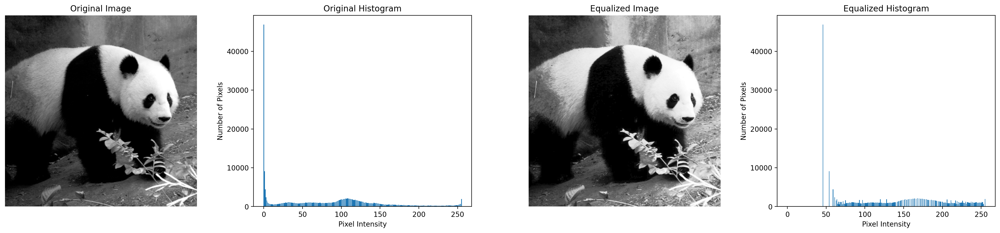

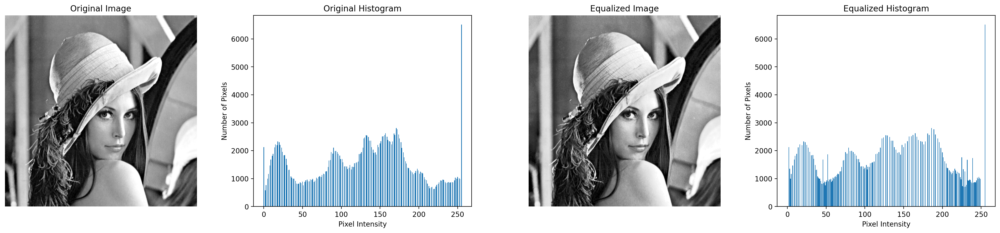

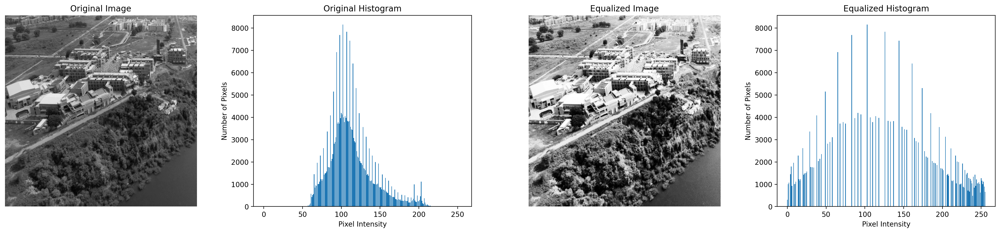

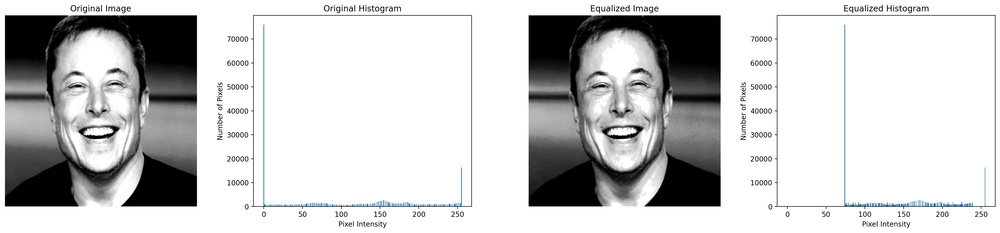

In [6]:
from IPython.display import Javascript
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

# Perform equalization on the 4 images
plot_equalized(img1,1)
plot_equalized(img2,2)
plot_equalized(img3,3)
plot_equalized(img4,4)

# **Histogram Matching**

Histogram Matching, also known as **Histogram Specification**, is a process where the pixel intensity distribution of one image (source) is modified to match the histogram of another image (target). This technique is particularly useful in applications like style transfer, medical imaging, and enhancing image similarity.

#### Steps for Histogram Matching:

1. **Perform Histogram Equalization** on both the source image $ A $ and the target image $ B $. This step normalizes their intensity distributions.
2. **Create a mapping** between the pixel intensity levels of the source and target images based on their equalized histograms:
   $$
   M(A_i) = B_j \quad \text{such that} \quad CDF_A(A_i) \approx CDF_B(B_j)
   $$
   This ensures that each intensity in $ A $ corresponds to an intensity in $ B $.
3. **Remap the pixel values of $ A $** using the mapping $ M $. This results in a transformed version of $ A $ whose histogram matches that of $ B $.


Use Case - Histogram Matching enables controlled manipulation of an image's appearance, allowing it to mimic the style or characteristics of another image.

## Match Histogram and Plot Function

In [ ]:
# Function defined to take source image and target image as input and return their mapping function, matched image and matched histogram
def histogram_matching(source_img,target_img,L=256):
  equalized_source_img, equalized_source_histogram = equalize_histogram(source_img)      # Calculate the Equalized Image and Equalized Histogram of the source image
  # equalized_target_img, equalized_target_histogram = equalize_histogram(target_img)    # Calculate the Equalized Image and Equalized Histogram of the target image
  target_histogram=calculate_histogram(target_img)
  mapping_function=np.zeros(L, dtype="int")                                              # Initialize the mapping function
  eq_source_cdf=np.cumsum(equalized_source_histogram)                                    # Calculate the cumulative sum of the equalized source histogram
  eq_target_cdf=np.cumsum(target_histogram)                                              # Calculate the cumulative sum of the equalized target histogram
  for i in range(L):
    mapping_function[i]=np.argmin(np.abs(eq_target_cdf-eq_source_cdf[i]))                # Find the mapping function
  matched_img=np.zeros_like(source_img)                                                  # Initialize the matched image with the same dimensions as the source iamge
  # for x in range(source_img.shape[0]):
  #   for y in range(source_img.shape[1]):
  #     pixel_value= (source_img[x][y])
  #     matched_img[x][y]=mapping_function[pixel_value]
  matched_img=mapping_function[equalized_source_img.astype(int)]                         # Find the matched image by replacing the intensity levels
  matched_hist=calculate_histogram(matched_img)                                          # Calcualte the histogram of the matched image by using the earlier defined fucntion
  return mapping_function, matched_img, matched_hist


# Function defined to show the source image, target image and their matched image and the matched histogram
def plot_matched(source, target, i):
  plt.figure(figsize=(24, 9))
  # Plot the histogram of the source image, target image and the matched image
  plt.subplot(2, 4, 1)
  source_hist = calculate_histogram(source)
  plot_histogram(source_hist)  
  plt.title("Source Histogram")
  plt.subplot(2, 4, 2)
  target_hist = calculate_histogram(target)
  plot_histogram(target_hist)  
  plt.title("Target Histogram")
  plt.subplot(2, 4, 3)
  mapping_function, matched_img, matched_hist = histogram_matching(source, target)  
  plot_histogram(matched_hist)  
  plt.title("Matched Histogram")
  
  # Plot the source image, target image and the matched image
  plt.subplot(2, 4, 5)
  plt.imshow(source, cmap="gray") 
  plt.axis("off")
  plt.title("Source Image")
  plt.subplot(2, 4, 6)
  plt.imshow(target, cmap="gray") 
  plt.axis("off")
  plt.title("Target Image")
  plt.subplot(2, 4, 7)
  plt.imshow(matched_img, cmap="gray")  
  cv2.imwrite(f"./Saved Results/Matched_Image_{i}.png", matched_img)  # Save the matched image
  plt.title("Matched Image")
  plt.axis("off")
  plt.tight_layout()
  plt.show()

<IPython.core.display.Javascript object>

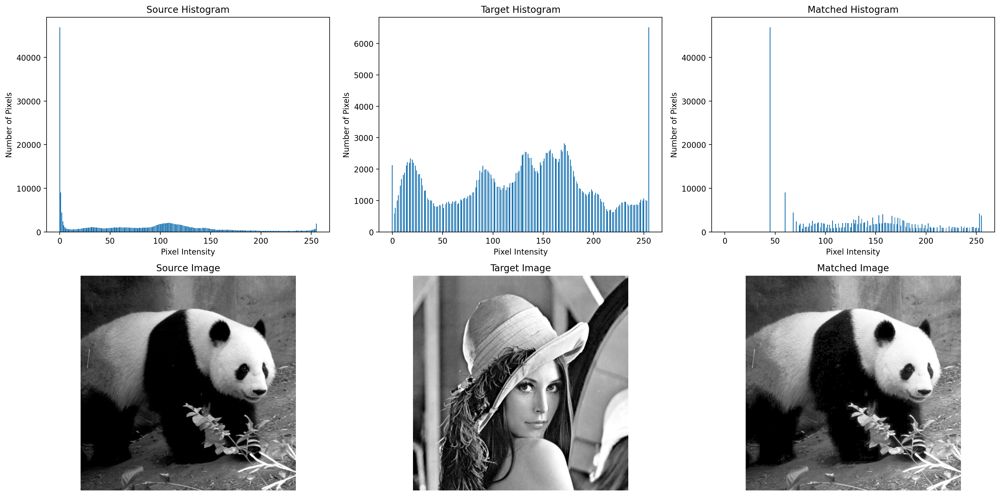

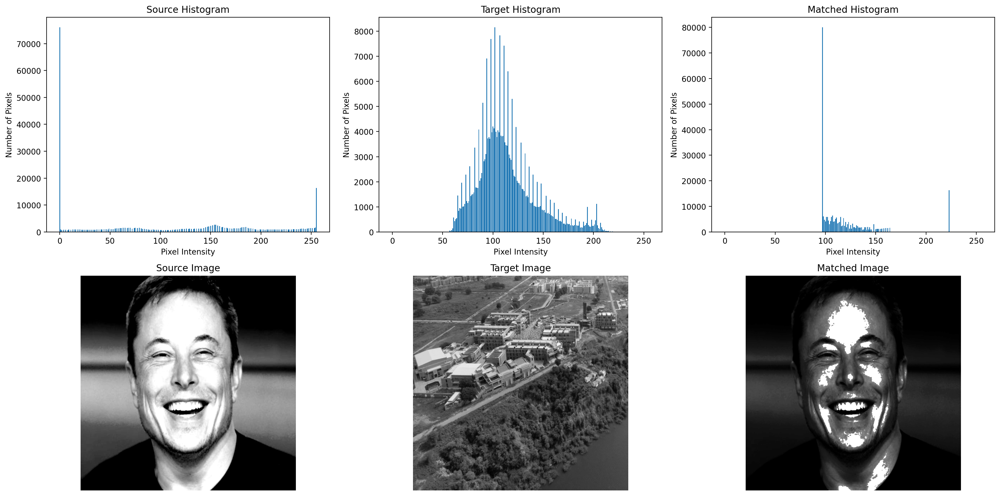

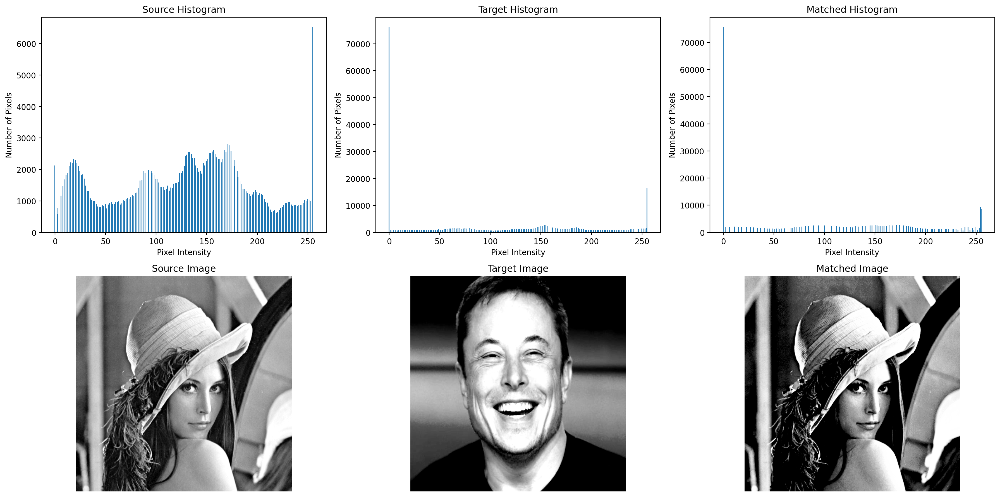

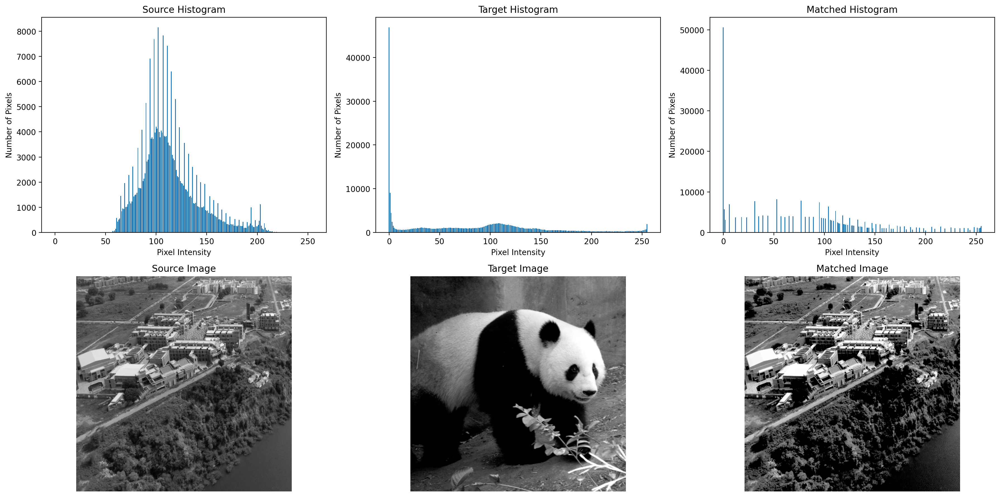

In [ ]:
from IPython.display import Javascript
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

# Perform matching on the 4 required combinations of source and target images
plot_matched(img1,img2,1)
plot_matched(img4,img3,2)
plot_matched(img2,img4,3)
plot_matched(img3,img1,4)

# **Final Results**

## Original Images

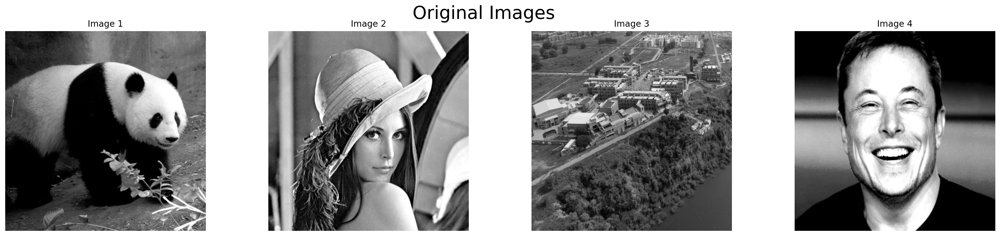

In [9]:
plt.figure(figsize=(25, 5))
plt.suptitle("Original Images", fontsize=25)
plt.subplot(1,4,1)
plt.imshow(img1, cmap="gray")
plt.axis("off")
plt.title("Image 1")
plt.subplot(1,4,2)
plt.imshow(img2, cmap="gray")
plt.axis("off")
plt.title("Image 2")
plt.subplot(1,4,3)
plt.imshow(img3, cmap="gray")
plt.axis("off")
plt.title("Image 3")
plt.subplot(1,4,4)
plt.imshow(img4, cmap="gray")
plt.axis("off")
plt.title("Image 4")
plt.show()

## Equalized Images

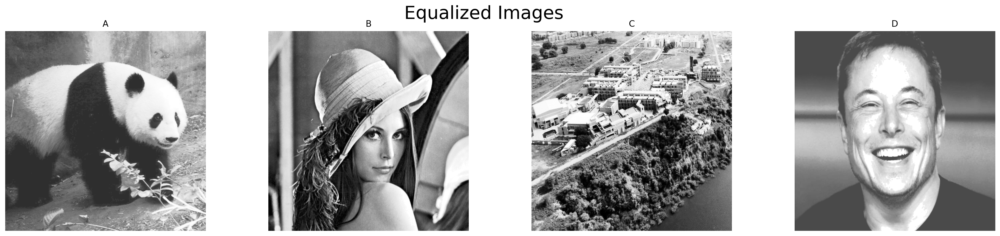

In [10]:
plt.figure(figsize=(25, 5))
plt.suptitle("Equalized Images", fontsize=25)
plt.subplot(1,4,1)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Equalized_Image_1.png"), cv2.COLOR_BGR2RGB))
plt.title("A")
plt.axis("off")
plt.subplot(1,4,2)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Equalized_Image_2.png"), cv2.COLOR_BGR2RGB))
plt.title("B")
plt.axis("off")
plt.subplot(1,4,3)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Equalized_Image_3.png"), cv2.COLOR_BGR2RGB))
plt.title("C")
plt.axis("off")
plt.subplot(1,4,4)
plt.imshow(cv2.cvtColor(cv2.imread("./Saved Results/Equalized_Image_4.png"), cv2.COLOR_BGR2RGB))
plt.title("D")
plt.axis("off")
plt.show()

## Matched Images

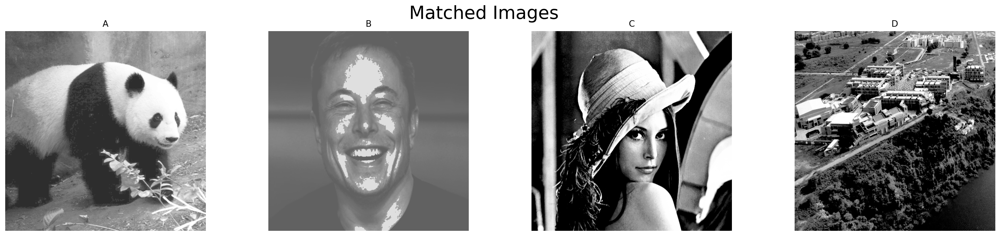

In [11]:
plt.figure(figsize=(25, 5))
plt.suptitle("Matched Images", fontsize=25)
plt.subplot(1,4,1)
plt.imshow(cv2.imread("./Saved Results/Matched_Image_1.png"), cmap="gray")
plt.title("A")
plt.axis("off")
plt.subplot(1,4,2)
plt.imshow(cv2.imread("./Saved Results/Matched_Image_2.png"), cmap="gray")
plt.title("B")
plt.axis("off")
plt.subplot(1,4,3)
plt.imshow(cv2.imread("./Saved Results/Matched_Image_3.png"), cmap="gray")
plt.title("C")
plt.axis("off")
plt.subplot(1,4,4)
plt.imshow(cv2.imread("./Saved Results/Matched_Image_4.png"), cmap="gray")
plt.title("D")
plt.axis("off")
plt.show()

# **Sample Results**

<IPython.core.display.Javascript object>

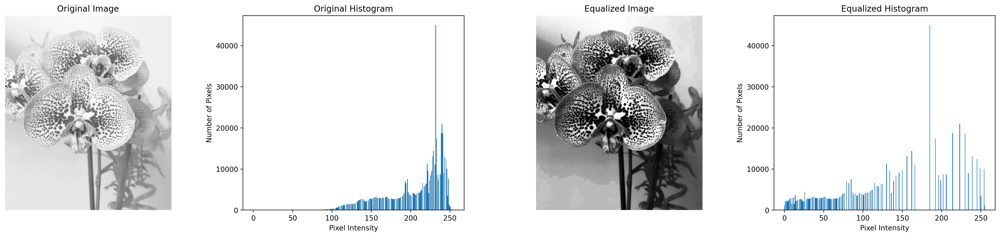

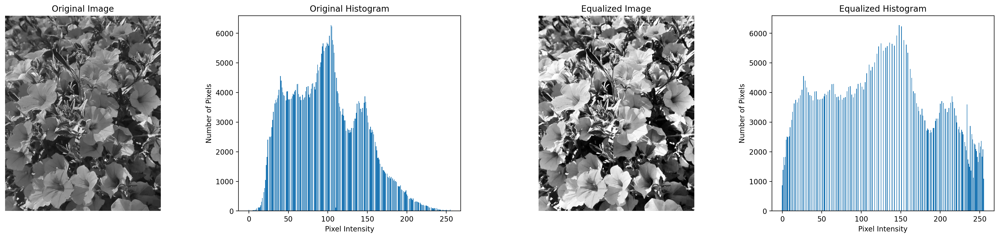

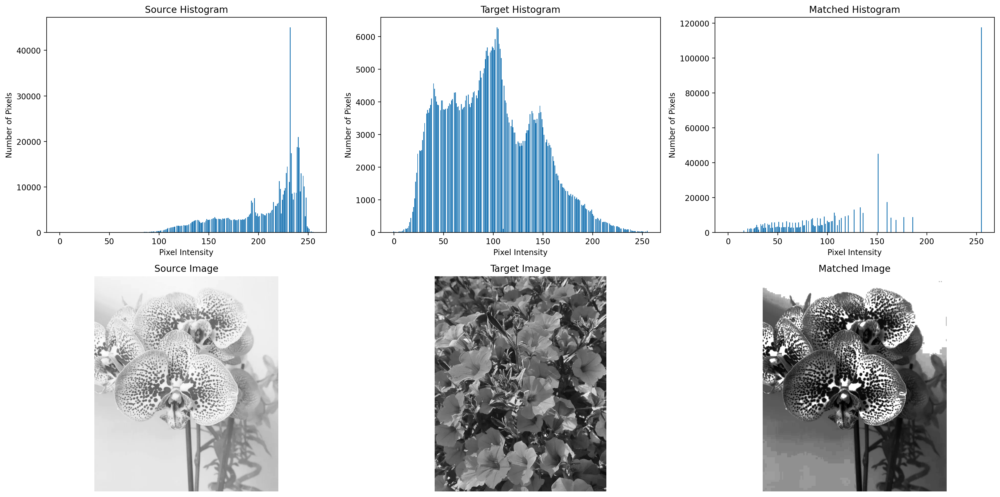

In [12]:
from IPython.display import Javascript
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

imgA=cv2.imread("./Dataset/sample_results/imageA.png",0)
imgB=cv2.imread("./Dataset/sample_results/imageB.png",0)
result=cv2.imread("./Dataset/sample_results/matched_image.png",0)
plot_equalized(imgA, "A")
plot_equalized(imgB, "B")
print()
plot_matched(imgA,imgB, "Sample")
# print(result)

# **Observations**

In this assignment, histogram equalization and histogram matching were performed on a set of images provided by the course instructor. For doing histogram equalization, the source image was equalized and matched with the target image. The observations that were found are as follows:

1.  After performing equalization on image histograms, it was observed that the contrast of the images improved. The dark and light became more distinguishable.

2. After performing histogram matching on a pair of source and target images, it was observed that the pixel intensities of the equalized source image were successfully aligned to the pixel intensities of the target image.





# References


1. “Histogram matching,” Wikipedia, Feb. 07, 2022. https://en.wikipedia.org/wiki/Histogram_matching

2. “matplotlib.pyplot.subplot — Matplotlib 3.4.3 documentation,” matplotlib.org. https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.subplot.html

3. “OpenCV: Image file reading and writing,” docs.opencv.org. https://docs.opencv.org/4.x/d4/da8/group__imgcodecs.html#ga288b8b3da0892bd651fce07b3bbd3a56

4. “How to Set a Single Main Title for All the Subplots in Matplotlib?,” GeeksforGeeks, Jan. 02, 2021. https://www.geeksforgeeks.org/how-to-set-a-single-main-title-for-all-the-subplots-in-matplotlib/ (accessed Mar. 04, 2024).

5. “Disabling auto-scroll of outputs · Issue #541 · googlecolab/colabtools,” GitHub. https://github.com/googlecolab/colabtools/issues/541#issue-440879358 (accessed Mar. 06, 2024).

6. Lab Discussion Notes provided in Google Classroom. https://drive.google.com/file/d/1cpLNt4j0TfbaS0pqvc6oLqKGE5YFzLel/view

7. Histogram Equalization Notes provided in Google Classroom. https://drive.google.com/file/d/1HNVVHTJm44cDu8SiBKWzYe5pho3s8oF3/view

8. Discussed the errors in the code and confirmed findings with Soham Gaonkar, Karan Gandhi, Umang Shikarvar and Abhinav



